# Pet Tornado *(OK, more like a waterspout)*

v1.3 28 May 2018, by Brian Fiedler, with Brian Mapes and David Nolan updates 2/20/2019

$\newcommand{\V}[1]{\vec{\boldsymbol{#1}}}$
$\newcommand{\I}[1]{\widehat{\boldsymbol{\mathrm{#1}}}}$
$\newcommand{\B}[1]{\overline{#1}}$ 
$\newcommand{\pd}[2]{\frac{\partial#1}{\partial#2}}$
$\newcommand{\dd}[2]{\frac{\D#1}{\D#2}}$
$\newcommand{\pdt}[1]{\frac{\partial#1}{\partial t}}$
$\newcommand{\ddt}[1]{\frac{\D#1}{\D t}}$
$\newcommand{\D}{\mathrm{d}}$
$\newcommand{\Ii}{\I{\imath}}$
$\newcommand{\Ij}{\I{\jmath}}$
$\newcommand{\Ik}{\I{k}}$
$\newcommand{\VU}{\V{U}}$
$\newcommand{\del}{\boldsymbol{\nabla}}$
$\newcommand{\dt}{\cdot}$
$\newcommand{\x}{\times}$
$\newcommand{\dv}{\del\cdot}$
$\newcommand{\curl}{\del\times}$
$\newcommand{\lapl}{\nabla^2}$
$\newcommand{\VI}[1]{\left\langle#1\right\rangle}$
$\require{color}$

### Sections
#### Code cells have to be up top (ugly), so here are jump links to the good stuff 
1. <a href="#Initialize">Choose parameters of experiment (grid and initial buoyant bubble)</a>
1. <a href="#Initialstate">Initialize state and show the initial conditions</a>
1. <a href="#Energy_stats_arrays">Energy stats (ke, pe, te) by timestep</a>
1. <a href="#Stepforward">Step forward in time, plotting the state at intervals</a>
1. <a href="#Animation_and_stats">Crude animation from .png frames, then plot energy statistic time series</a>
1. <a href="#Student_tasks">Student assignment tasks</a>

A cubic domain, a box,  with a buoyant blob is rotating (slowly) about it's central axis.  The blob rises and creates
relative vorticity below.  The stretching and amplification of the vorticity bears some resemblance to the formation of tornadoes within mesoscylones.

The model equations look like they have a coriolis parameter in them, because the domain is rotating (and embedded within) the mesocyclone. Use your imagination.

In [435]:
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import display,clear_output, Image
import time as Time
import math, os, glob
import numpy as np
import scipy.fftpack
import matplotlib
matplotlib.rcParams.update({'font.size': 22})
from IPython.core.display import HTML
import urllib.request
from matplotlib.ticker import FormatStrFormatter

In [436]:
# Set some notebook style parameters
#HTML(urllib.request.urlopen('http://metrprof.xyz/metr4323.css').read().decode())
#HTML( open('metr4323.css').read() ) #or use this, if you have downloaded metr4233.css to your computer

We prognosticate the following dimensionless equations:

$$
\pdt{u} + u \pd{u}{x} + v \pd{u}{y} + w \pd{u}{z}= - \pd{P}{x} + \frac{f}{N} v
$$

$$
\pdt{v}{t} + u \pd{v}{x} + v \pd{v}{y} + w \pd{v}{z}=  - \pd{P}{y} - \frac{f}{N} u
$$

$$
\pdt{w} + u \pd{w}{x} + v \pd{w}{y} + w \pd{w}{z}= - \pd{P}{z} + b 
$$

$$
\pd{u}{x} + \pd{v}{y} + \pd{w}{z}  = 0
$$

$$
\pdt{b} + u \pd{b}{x} + v \pd{b}{y} + w \pd{b}{z}= - w 
$$

The non-dimensionalization should be familiar to you. Note the time scale is $1/N$, not seconds.
In the code below, we use `fcoriolis`=$f/N$  

In [437]:
################
def ab_blend(dqdt,order):
# blends the time derivatives for the 1st, 2nd and 3rd order Adams-Bashforth schemes
    if order==1:
        return dqdt[0]
    elif order==2:
        return 1.5*dqdt[0]-.5*dqdt[1]
    elif order==3:
        return (23*dqdt[0]-16*dqdt[1]+5*dqdt[2])/12.
    else:
        print("order", order ," not supported ")


## Some functions for the 3-D C-grid

In [438]:
##############################################    
def make3dgrid(ix,iy,iz,xmax,ymax,zmax):
# input number of desired gridpoints, and the span of the grid,
# return 3-D arrays of the x y and z coordinates at the grid points
    dx=xmax/(ix-1.)
    dy=ymax/(iy-1.)
    dz=zmax/(iz-1.)
    x1=np.linspace(0,xmax,ix)
    y1=np.linspace(0,ymax,iy)
    z1=np.linspace(0,zmax,iz)
    x=np.zeros( (iz,iy,ix) )
    y=np.zeros( (iz,iy,ix) )
    z=np.zeros( (iz,iy,ix) )
    for j in range(iy):
        for k in range(iz):
            x[k,j,:]=x1
    for i in range(ix):
        for k in range(iz):
            y[k,:,i]=y1
    for i in range(ix):
        for j in range(iy):
            z[:,j,i]=z1
    return x,y,z,dx,dy,dz

##############################################    
def advect_3d(q,u,v,w,dx,dy,dz):
# 3rd-order upwind advection
    dqdt=np.zeros(q.shape)
    dqmx=np.zeros(q.shape)
    dqpx=np.zeros(q.shape)
    dqmy=np.zeros(q.shape)
    dqpy=np.zeros(q.shape)
    dqmz=np.zeros(q.shape)
    dqpz=np.zeros(q.shape)

# "m" is difference biased to the minus side, "p" to the plus side
# must use first order "#1" if too close to wall
    dqmx[:,:,1]  = q[:,:,1]-q[:,:,0]  #1
    dqmx[:,:,2:-1] = (2*q[:,:,3:]+3*q[:,:,2:-1]-6*q[:,:,1:-2]+q[:,:,:-3])/6. #3
    dqpx[:,:,-2] = q[:,:,-1]-q[:,:,-2] #1
    dqpx[:,:,1:-2] = -(2*q[:,:,0:-3]+3*q[:,:,1:-2]-6*q[:,:,2:-1]+q[:,:,3:])/6. #3

    dqmy[:,1,:]  = q[:,1,:]-q[:,0,:] #1
    dqmy[:,2:-1,:] =  (2*q[:,3:,:]+3*q[:,2:-1,:]-6*q[:,1:-2,:]+q[:,:-3,:])/6. #3
    dqpy[:,-2,:] = q[:,-1,:]-q[:,-2,:] #1
    dqpy[:,1:-2,:] = -(2*q[:,0:-3,:]+3*q[:,1:-2,:]-6*q[:,2:-1,:]+q[:,3:,:])/6. #3

    dqmz[1,:,:]  = q[1,:,:]-q[0,:,:]  #1
    dqmz[2:-1,:,:] = (2*q[3:,:,:]+3*q[2:-1,:,:]-6*q[1:-2,:,:]+q[:-3,:,:])/6. #3
    dqpz[-2,:,:] = q[-1,:,:]-q[-2,:,:] #1
    dqpz[1:-2,:,:] = -(2*q[0:-3,:,:]+3*q[1:-2,:,:]-6*q[2:-1,:,:]+q[3:,:,:])/6. #3

# use derivatives biased to the upwind side:
    dqdx=np.where(u>0.,dqmx,dqpx)/dx
    dqdy=np.where(v>0.,dqmy,dqpy)/dy
    dqdz=np.where(w>0.,dqmz,dqpz)/dz

# advective terms:
    dqdt+=-u*dqdx
    dqdt+=-v*dqdy
    dqdt+=-w*dqdz
    return dqdt


In [439]:
############################################## 
# periodic version
def advect_3dp(q,u,v,w,dx,dy,dz,per='U'): 
# 3rd-order upwind advection
    sh = q.shape
    Q = np.zeros( (sh[0],sh[1]+4,sh[2]+4) )
    Q[:, 2:-2 , 2:-2] = q
    
    if per=='U':        
        Q[ : , :2 , 2:-2 ] = q[ : , -3:-1 , : ]
        Q[ : , -2: , 2:-2] = q[ : , 1:3 , : ]
        Q[ : , 2:-2 , :2] = q[ : , : , -3:-1 ]
        Q[ : , 2:-2 , -2:] = q[ : , : , 1:3 ]
    elif per=='u':
        Q[ : , :2 , 2:-2 ]  = q[ : , -2: , : ]
        Q[ : , -2: , 2:-2 ] = q[ : , :2  , : ]
        Q[ : , 2:-2 , :2 ]  = q[ : , : , -3:-1 ]
        Q[ : , 2:-2 , -2: ] = q[ : , : , 1:3 ]
    elif per=='v':
        Q[ : , :2 , 2:-2 ]  = q[ : , -3:-1 , : ]
        Q[ : , -2: , 2:-2 ] = q[ : , 1:3  , : ]
        Q[ : , 2:-2 , :2 ]  = q[ : , : , -2: ]
        Q[ : , 2:-2 , -2: ] = q[ : , : , :2 ] 
    elif per=='w':
        Q[ : , :2 , 2:-2 ]  = q[ : , -2: , : ]
        Q[ : , -2: , 2:-2 ] = q[ : , :2  , : ]
        Q[ : , 2:-2 , :2 ]  = q[ : , : , -2: ]
        Q[ : , 2:-2 , -2: ] = q[ : , : , :2 ] 
        
    
    dqdt=np.zeros(sh)
    dqmx=np.zeros(sh)
    dqpx=np.zeros(sh)
    dqmy=np.zeros(sh)
    dqpy=np.zeros(sh)
    dqmz=np.zeros(sh)
    dqpz=np.zeros(sh)

# "m" is difference biased to the minus side, "p" to the plus side
# must use first order "#1" if too close to wall
    
    dqmx[:,:,:] =  (2*Q[:,2:-2,3:-1] + 3*Q[:,2:-2,2:-2] - 6*Q[:,2:-2,1:-3] + Q[:,2:-2,:-4])/6. 
    dqpx[:,:,:] = -(2*Q[:,2:-2,1:-3] + 3*Q[:,2:-2,2:-2] - 6*Q[:,2:-2,3:-1] + Q[:,2:-2,4:] )/6.
    
    dqmy[:,:,:] =  (2*Q[:,3:-1,2:-2] + 3*Q[:,2:-2,2:-2] - 6*Q[:,1:-3,2:-2] + Q[:,:-4,2:-2])/6. 
    dqpy[:,:,:] = -(2*Q[:,1:-3,2:-2] + 3*Q[:,2:-2,2:-2] - 6*Q[:,3:-1,2:-2] + Q[:,4:,2:-2] )/6. 

    dqmz[1,:,:]  = q[1,:,:]-q[0,:,:]  #1
    dqmz[2:-1,:,:] = (2*q[3:,:,:]+3*q[2:-1,:,:]-6*q[1:-2,:,:]+q[:-3,:,:])/6. #3
    dqpz[-2,:,:] = q[-1,:,:]-q[-2,:,:] #1
    dqpz[1:-2,:,:] = -(2*q[0:-3,:,:]+3*q[1:-2,:,:]-6*q[2:-1,:,:]+q[3:,:,:])/6. #3

# use derivatives biased to the upwind side:
    dqdx=np.where(u>0.,dqmx,dqpx)/dx
    dqdy=np.where(v>0.,dqmy,dqpy)/dy
    dqdz=np.where(w>0.,dqmz,dqpz)/dz

# advective terms:
    dqdt+=-u*dqdx
    dqdt+=-v*dqdy
    dqdt+=-w*dqdz
    return dqdt


In [440]:
# divergence on the C-grid
def div_Cgrid(u,v,w,dx,dy,dz):
    return (u[:,:,1:]-u[:,:,:-1])/dx + (v[:,1:,:]-v[:,:-1,:])/dy + (w[1:,:,:]-w[:-1,:,:])/dz

In [441]:
def pgf_3dp(p,dx,dy,dz):
# 20 May 2016 Periodic
# Calculates periodic pressure gradient force on the U-grid

    dudt=np.zeros( (p.shape[0]+1, p.shape[1]+1 , p.shape[2]+1 ) )
    dvdt=np.zeros( dudt.shape )
    dwdt=np.zeros( dudt.shape )

    
    P = np.zeros( (p.shape[0], p.shape[1]+2 , p.shape[2]+2 ) )
    P[:,1:-1,1:-1] = p
    P[:,0,1:-1] = p[:,-1,:]
    P[:,-1,1:-1] = p[:,0,:]
    P[:,1:-1,0] = p[:,:,-1]
    P[:,1:-1,-1] = p[:,:,0]
    
    dpx = (P[:,:,1:]-P[:,:,:-1])/dx 
    dudt[ 1:-1 , : , : ] = -.25* ( dpx[:-1,:-1,:] + dpx[:-1,1:,:]  
                                  +dpx[1:,:-1,:]  + dpx[1:,1:,:] )    
    dudt[ 0, : , :]  =  -.5*(dpx[0,1:,:] + dpx[0,:-1,:] ) 
    dudt[-1 ,: , :] =  -.5*(dpx[-1,1:,:] + dpx[-1,:-1,:] ) 
    
    dpy =  (P[:,1:,:]-P[:,:-1,:])/dy 
    dvdt[1:-1,:,:] = -.25* ( dpy[:-1,:,:-1] + dpy[:-1,:,1:] 
                                  +dpy[1:,:,:-1] + dpy[1:,:,1:] ) 
    dvdt[0, : , :] = -.5* ( dpy[0,:,1:] + dpy[0,:,:-1] ) 
    dvdt[-1,: , :] = -.5* ( dpy[-1,:,1:] + dpy[-1,:,:-1] ) 
   
    dpz =  (P[1:,:,:]-P[:-1,:,:])/dz 
    dwdt[1:-1, :, :] = -.25* ( dpz[:,:-1,:-1] + dpz[:,:-1,1:] 
                              +dpz[:,1:,:-1] + dpz[:,1:,1:] ) 
    
    return dudt,dvdt,dwdt


In [442]:
############
#Interpolators for the C grid
def v_to_u(v,bnd='slip'):
    iz,iy,ix = v.shape
    atu=np.zeros((iz,iy-1,ix+1))
    atu[:,:,1:-1] = .25*( v[:,:-1,:-1] + v[:,:-1,1:] + v[:,1:,:-1] + v[:,1:,1:] )
    if bnd=='slip':
        atu[:,:,0] = atu[:,:,1]
        atu[:,:,-1] = atu[:,:,-2]
    elif bnd=='per':
        atu[:,:,0] = .25*( v[:,:-1,-1] + v[:,:-1,0] + v[:,1:,-1] + v[:,1:,0] )
        atu[:,:,-1] = atu[:,:,0]
    else:
        sys.exit('nothing for: '+bnd)
    return atu
def w_to_u(w,bnd='slip'):
    iz,iy,ix = w.shape
    atu=np.zeros((iz-1,iy,ix+1))
    atu[:,:,1:-1] = .25*( w[:-1,:,:-1] + w[:-1,:,1:] + w[1:,:,:-1] + w[1:,:,1:] )
    if bnd=='slip':
        atu[:,:,0] = atu[:,:,1]
        atu[:,:,-1] = atu[:,:,-2]
    elif bnd=='per':
        atu[:,:,0] = .25*( w[:-1,:,-1] + w[:-1,:,0] + w[1:,:,-1] + w[1:,:,0] )
        atu[:,:,-1] = atu[:,:,0]
    else:
        sys.exit('nothing for: '+bnd)
    return atu
def u_to_v(u,bnd='slip'):
    iz,iy,ix = u.shape
    atv=np.zeros((iz,iy+1,ix-1))
    atv[:,1:-1,:] = .25*( u[:,:-1,:-1] + u[:,:-1,1:] + u[:,1:,:-1] + u[:,1:,1:] )
    if bnd=='slip':
        atv[:,0,:] = atv[:,1,:]
        atv[:,-1,:] = atv[:,-2,:]
    elif bnd=='per':
        atv[:,0,:] = .25*( u[:,-1,:-1] + u[:,-1,1:] + u[:,0,:-1] + u[:,0,1:] )
        atv[:,-1,:] = atv[:,0,:]
    else:
        sys.exit('nothing for: '+bnd)
    return atv
def w_to_v(w,bnd='slip'):
    iz,iy,ix = w.shape
    atv=np.zeros((iz-1,iy+1,ix))
    atv[:,1:-1,:] = .25*( w[:-1,:-1,:] + w[:-1,1:,:] + w[1:,:-1,:] + w[1:,1:,:] )
    if bnd=='slip':
        atv[:,0,:] = atv[:,1,:]
        atv[:,-1,:] = atv[:,-2,:]
    elif bnd=='per':
        atv[:,0,:] = .25*( w[:-1,-1,:] + w[:-1,0,:] + w[1:,-1,:] + w[1:,0,:] )
        atv[:,-1,:] = atv[:,0,:]
    else:
        sys.exit('nothing for: '+bnd)
    return atv

def u_to_w(u,bnd='slip'):
    iz,iy,ix = u.shape
    atw=np.zeros((iz+1,iy,ix-1))
    atw[1:-1,:,:] = .25*( u[:-1,:,:-1] + u[:-1,:,1:] + u[1:,:,:-1] + u[1:,:,1:] )
    if bnd=='slip':
        atw[0,:,:] = atw[1,:,:]
        atw[-1,:,:] = atw[-2,:,:]
    else:
        sys.exit('nothing for: '+bnd)
    return atw
def v_to_w(v,bnd='slip'):
    iz,iy,ix = v.shape
    atw=np.zeros((iz+1,iy-1,ix))
    atw[1:-1,:,:] = .25*( v[:-1,:-1,:] + v[:-1,1:,:] + v[1:,:-1,:] + v[1:,1:,:] )
    if bnd=='slip':
        atw[0,:,:]=atw[1,:,:]
        atw[-1,:,:]=atw[-2,:,:]
    else:
        sys.exit('nothing for: '+bnd)
    return atw

# These are easy for the C-grid.
def u_to_p(u):
    return (u[:,:,:-1] + u[:,:,1:] )*.5
def v_to_p(v):
    return (v[:,:-1,:] + v[:,1:,:] )*.5        
def w_to_p(w):
    return (w[:-1,:,:] + w[1:,:,:] )*.5   

#############################################################
def U2p_3d(U):
# interpolates U-grid array to a p-grid array
    return .125*( U[1:,:-1,1:]  + U[1:,1:,1:]  + U[1:,:-1,:-1]  + U[1:,1:,:-1]
                + U[:-1,:-1,1:] + U[:-1,1:,1:] + U[:-1,:-1,:-1] + U[:-1,1:,:-1])

In [443]:
#######################3
# Expands the margins of a matplotlib axis, 
# and so prevents arrows on boundaries from being clipped. 
def stop_clipping(ax,marg=.02): # default is 2% increase
    l,r,b,t = ax.axis()
    dx,dy = r-l, t-b
    ax.axis([l-marg*dx, r+marg*dx, b-marg*dy, t+marg*dy])

# non-hydrostatic pressure solver

In [444]:
def lapl_p_3d(p,dx,dy,dz):
# Returns Laplacian of p, d^2p/dx^2 + d^2/dy^2 + d^2/dz^2,
# assumimg no normal pressure gradient at boundaries.
# Uses image points outside of the domain of p, so the returned laplacian
# is the same size as p
    sh=p.shape
    b = np.zeros((sh[0]+2,sh[1]+2,sh[2]+2)) # make bigger array
    # stuff in image point values:
    b[1:-1,1:-1,1:-1]=p
    b[1:-1,1:-1,0]=p[:,:,0]
    b[1:-1,1:-1,-1]=p[:,:,-1]
    b[1:-1,0,1:-1]=p[:,0,:]
    b[1:-1,-1,1:-1]=p[:,-1,:]
    b[0,1:-1,1:-1]=p[0,:,:]
    b[-1,1:-1,1:-1]=p[-1,:,:]
    dx2=dx*dx
    dy2=dy*dy
    dz2=dz*dz
    laplp=np.zeros(sh)
    laplp += (-2*b[1:-1,1:-1,1:-1] + b[1:-1,1:-1,:-2] + b[1:-1,1:-1,2:])/dx2
    laplp += (-2*b[1:-1,1:-1,1:-1] + b[1:-1,2:,1:-1] + b[1:-1,:-2,1:-1])/dy2
    laplp += (-2*b[1:-1,1:-1,1:-1] + b[2:,1:-1,1:-1] + b[:-2,1:-1,1:-1])/dz2
    return laplp

def lapl_p_3d_periodic(p,dx,dy,dz):
# Returns Laplacian of p, d^2p/dx^2 + d^2/dy^2 + d^2/dz^2,
# assumimg x and y are periodic, and no normal pressure gradient at top and bottom
# Uses image points outside of the domain of p, so the returned Laplacian
# is the same size as p
    sh=p.shape
    b = np.zeros((sh[0]+2,sh[1]+2,sh[2]+2)) # make bigger array
    # stuff in image point values:
    b[1:-1,1:-1,1:-1]=p
    b[1:-1,1:-1,0]=p[:,:,-1]
    b[1:-1,1:-1,-1]=p[:,:,0]
    b[1:-1,0,1:-1]=p[:,-1,:]
    b[1:-1,-1,1:-1]=p[:,0,:]
    b[0,1:-1,1:-1]=p[0,:,:]
    b[-1,1:-1,1:-1]=p[-1,:,:]
    dx2=dx*dx
    dy2=dy*dy
    dz2=dz*dz
    laplp = np.zeros(sh)
    laplp += (-2*b[1:-1,1:-1,1:-1] + b[1:-1,1:-1,:-2] + b[1:-1,1:-1,2:])/dx2
    laplp += (-2*b[1:-1,1:-1,1:-1] + b[1:-1,2:,1:-1] + b[1:-1,:-2,1:-1])/dy2
    laplp += (-2*b[1:-1,1:-1,1:-1] + b[2:,1:-1,1:-1] + b[:-2,1:-1,1:-1])/dz2
    return laplp

def poisson3d_p_fft_prep(sh,dx,dy,dz,lapl='discrete',periodic=False):
    
    # You must run this and save the array output for input into poisson_cosine_3.
    # poisson_cosine_3 is for box domains with boundary conditions of no normal
    # pressure gradient. As such, the pressure can be represented by a 3-D Fourier
    # cosine series.
        
    L = dx*sh[2] 
    W = dy*sh[1]
    H = dz*sh[0]
    
    Ka = np.arange(sh[2]) # the wavenumbers of the cos functions in the x-direction
    Ma = np.arange(sh[1]) # ... in the y-direction
    Na = np.arange(sh[0]) # ... in the z-direction  
    
    if periodic: # use both sine and cosine
        Ka[1::2] += 1 
        Ma[1::2] += 1
      
    ka = Ka*np.pi/L
    ma = Ma*np.pi/W
    na = Na*np.pi/H

    # Suppose we have an amplitude of a certain Fourier mode of del2p.
    # (Usually del2p is the divergence of acceleration prior to adding the PGF.)
    # We want to find a mode of p such that the finite-difference form of 
    # Laplacian operator operating on p give this amplitude. 
    # The reciprocal of the lapl_op multipled by the amplitude of the Fourier
    # mode of del2p will give the amplitude of this Fourier mode of p.
    # Note: the continuous form, as opposed to discrete form, of lapl_op is very simple.
    # You are welcome to uncomment it and experiment with it.
    
    lapl_op = np.zeros(sh)
    if lapl == 'discrete':
        lapl_op[:] = (2*np.cos(ka*dx)-2)/dx**2
        more =  (2*np.cos(ma*dy)-2)/dy**2
        lapl_op += more.reshape(1,sh[1],1)
        more =  (2*np.cos(na*dz)-2)/dz**2
        lapl_op += more.reshape(sh[0],1,1)
    else: # use simple, calculus form for d^2/dx^2, etc.
        lapl_op[:] = -ka**2
        more = -ma**2 
        lapl_op += more.reshape(1,sh[1],1)    
        more = -na**2
        lapl_op += more.reshape(sh[0],1,1)
    
    lapl_op[0,0,0]=1. # Prevents division by zero. (The [0,0,0] Fourier mode is zero anyways)
    
    return 1./lapl_op # the inverse Laplacian operator

def poisson3d_p_fft(del2p,inv_lapl_op,periodic=False):
    
    # 3-D pressure solver
    # del2p is the desired Laplacian of pressure.
    # inv_lapl_op is from poisson_cosine_3_prep
    # pressure is assumed to have no normal pressure gradient at boundaries.
    # Assumes a C-grid.  The physical boundary is half a grid cell away from 
    # the pressure points. Thus type=2. 
    # dct means discrete cosine transform.
    # p has the same shape as d2p.  Fastest shape (64,64,64), (128,128,128), etc
    
    if not periodic:
        sh = del2p.shape
        del2pt = scipy.fftpack.dct( del2p , axis=2, type=2) 
        del2pt = scipy.fftpack.dct( del2pt , axis=1, type=2)
        del2pt = scipy.fftpack.dct( del2pt , axis=0, type=2)
        # del2pt is now the amplitudes of the Fourier modes of del2p

        pt = del2pt*inv_lapl_op # amplitudes of Fourier modes of pressure

        pt = scipy.fftpack.idct(pt,axis=0,type=2) # inverse transform of pt to p
        pt = scipy.fftpack.idct(pt,axis=1,type=2) # inverse transform of pt to p
        p = scipy.fftpack.idct(pt,axis=2,type=2) # inverse transform of pt to p
        p = p/(8*sh[0]*sh[1]*sh[2]) #The need for this division is convention of fft
        p -= p.mean() 

    else:
        sh = del2p.shape
        del2pt = scipy.fftpack.rfft( del2p , axis=2) 
        del2pt = scipy.fftpack.rfft( del2pt , axis=1)
        del2pt = scipy.fftpack.dct( del2pt , axis=0, type=2)
        # del2pt is now the amplitudes of the Fourier modes of del2p

        pt = del2pt*inv_lapl_op # amplitudes of Fourier modes of pressure

        pt = scipy.fftpack.idct(pt,axis=0,type=2) # inverse transform of pt to p
        pt = scipy.fftpack.irfft(pt,axis=1) # inverse transform of pt to p
        p = scipy.fftpack.irfft(pt,axis=2) # inverse transform of pt to p
        p = p/(2*sh[0]) #The need for this division is convention of fft
        p -= p.mean() 
    
    return p    

def vortp(u,v,dx,dy):
    # We have shapes v = (64,65,64), and u = (64,64,65) and we want to subtract 
    # one from the other to determine vorticity. We do so in a two step process
    # (1) Decrease 65 elements in u,v, positions to 64 in order to add two same-sized arrays
    vortu=np.zeros((pi.shape[0],vi.shape[1],ui.shape[2])); vortv=vortu.copy()
    vortu[:,1:-1,:]=(u[:,1:,:]-u[:,:-1,:])/dy; vortv[:,:,1:-1]=(v[:,:,1:]-v[:,:,:-1])/dx
    
        
    # (2) We now have two arrays of (64,64,64) and can determine dv/dx - du/dy
    vort = vortv - vortu
    return vort

def poisson_fft(vort, inv_lapl_op): 
    # solves for psi in del^2 psi = vort 
    cv = vort[1:-1,1:-1] # central vorticity
    
    #convert gridded vorticity to gridded Fourier coefficients A_k,m
    cvt = scipy.fftpack.dst( cv , axis=1 , type=1) 
    cvt = scipy.fftpack.dst( cvt , axis=0 , type=1)  
   
    cpsit = cvt*inv_lapl_op # Calculate B_k,m from A_k,m
    
    # convert array of Fourier coefficents for psi to gridded central psi
    cpsit = scipy.fftpack.idst(cpsit,axis=0,type=1) # inverse transform 
    cpsi = scipy.fftpack.idst(cpsit,axis=1,type=1) # inverse transform 

    sh = vort.shape
    psi = np.zeros(sh) # we need 0 on boundaries, next line fills the center
    psi[1:-1,1:-1] = cpsi/(4*(sh[0]-1)*(sh[1]-1)) # apply normalization convention of FFT
    return psi  



## Test the non-hydrostatic pressure solver

In [445]:
Nx,Ny,Nz = 129,129,129  # pressure solver much faster
#Nx,Ny,Nz = 128,128,128  # pressure solver very slow
xmax=1.
ymax=2.
zmax=3.
np.random.seed(2)
p_orig = np.random.random((Nz-1,Ny-1,Nx-1))
p_orig -= p_orig.mean()
dx = xmax/(Nx-1) 
dy = ymax/(Ny-1)
dz = zmax/(Nz-1)

#uncomment either the cosine or periodic stuff
#lapl_of_p = lapl_p_3d(p_orig, dx, dy,dz)
#inv_lapl_op = poisson_cosine_3_prep(lapl_of_p,dx,dy,dz)
#pp = poisson_cosine_3(lapl_of_p,inv_lapl_op)

peri = True
if peri:
    lapl_of_p = lapl_p_3d_periodic(p_orig, dx, dy, dz)
else:
    lapl_of_p = lapl_p_3d(p_orig, dx, dy, dz)
inv_lapl_op = poisson3d_p_fft_prep(lapl_of_p.shape,dx,dy,dz,lapl='discrete',periodic=peri)
pp = poisson3d_p_fft(lapl_of_p,inv_lapl_op,periodic=peri)

pp -= pp.mean()
d2=( pp - p_orig )**2
error= np.sqrt( d2.mean() )
print("should be small:", error)

should be small: 1.3162873273017309e-15


In [446]:
%%timeit
pp = poisson3d_p_fft(lapl_of_p,inv_lapl_op)

183 ms ± 19.2 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


<hr/>
<hr/>
<a name="Initialize"></a>
# Choose the grid and experiment, and initialize the fields

In [447]:
### Hey students! After running the above housekeeping cells, here you set up experiments:

expname = "ctrl"
fcoriolis = 1. # 0,1,2,3, are interesting choices
outdir = expname # directory name for your experiment
Nx,Ny,Nz = 65,65,65 # Pressure grid is one smaller. Fastest if Nx-1 = 2^n for integer n.
periodic = False # not tested much for True
bmax = 0.5 # how buoyant is the bubble? 0.5 is control run value
rbmax = 0.2 # radius of spherical bubble in which b(r) = bmax * cos(r)

### End changeable parameters


### rarely change the following:
aborder = 3 # 3rd order Adams-Bashforth
xmax,ymax,zmax = 1.,1.,1. #

In [448]:
xU,yU,zU,dx,dy,dz = make3dgrid(Nx,Ny,Nz,xmax,ymax,zmax)
print("dx=",dx,"dy=",dy,"dz=",dz)
print("range=",xU.max(),yU.max(),zU.max())

# for both C-grid and B-grid:
xp=U2p_3d(xU)
yp=U2p_3d(yU)
zp=U2p_3d(zU)

xw = .25*( xU[:,:-1,:-1] + xU[:,1:,:-1] + xU[:,:-1,1:] + xU[:,1:,1:] )
yw = .25*( yU[:,:-1,:-1] + yU[:,1:,:-1] + yU[:,:-1,1:] + yU[:,1:,1:] )
zw = zU[:,1:,1:].copy()
xb=xw
yb=yw
zb=zw

    

dx= 0.015625 dy= 0.015625 dz= 0.015625
range= 1.0 1.0 1.0


<a name="Initialstate"></a>
<hr/>
## Initialize the model

In [449]:
ui=np.zeros((Nz-1,Ny-1,Nx))
vi=np.zeros((Nz-1,Ny,Nx-1))
wi=np.zeros((Nz,Ny-1,Nx-1))
pi=np.zeros((Nz-1,Ny-1,Nx-1))

vort0 = vortp(ui,vi,dx,dy)          # Vertical vorticity 
circ0 = dx*dy*vort0.sum()

# Initialize the bi array with a warm bubble 
r2 = (xb/xmax-.5)**2 + (yb/ymax-.5)**2 + (zb/zmax-.2)**2 # squared distance from bubble center
rb = np.sqrt(r2)/rbmax                                   # rb goes to 1 at radius rbmax
bi=np.where(rb<1.,bmax*(1.+np.cos(np.pi*rb)),0.)         # where rb<1 =True, yield b>0, otherwise yield b=0.
ci=zb                                                    # add tracer
CI=ci.sum()                                              # how much tracer do we begin with?
print('%.2f' %(CI))                                      
idx=round(xb.shape[0]/2); buoy = 0.0
bi[0,idx]=buoy # adding buoyancy

# prepare template for inverse laplacian operation for this domain 
inv_lapl_op = poisson3d_p_fft_prep(pi.shape,dx,dy,dz,lapl='discrete',periodic=periodic)

133120.00


Text(0.5, 1.0, 'Horiz. cross section of b and $\\zeta$')

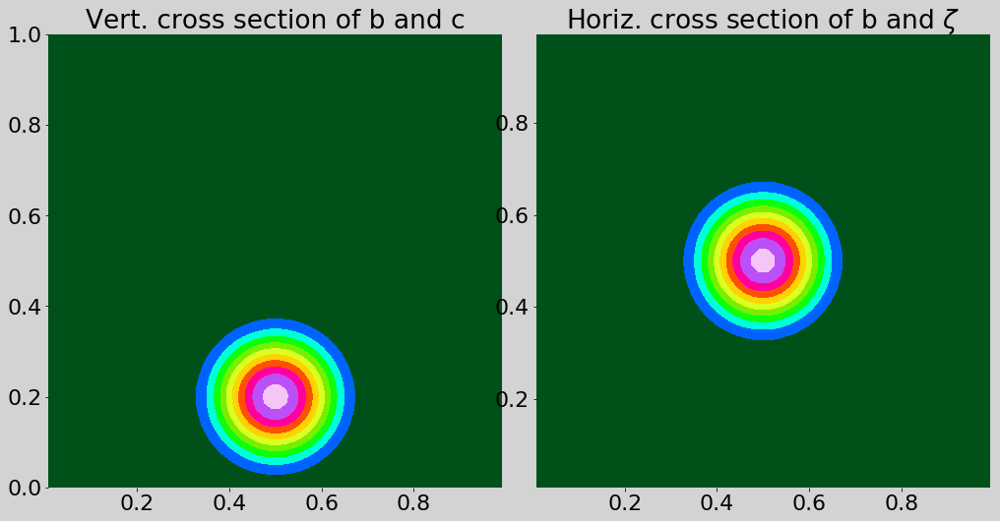

In [450]:
#quick,simple=plt.subplots(figsize=(12,6))
myfig = plt.figure(figsize=(16,8),facecolor='lightgrey')
ax1 = myfig.add_axes([0.08, 0.1, 0.4, .8*zmax/xmax],frameon=False) #vertical cross-section
ax2 = myfig.add_axes([0.51, 0.1, 0.4, .8*zmax/xmax],frameon=False) #horizontal cross-section
jp = Ny//2
kp = (Nz-1)//5
plt.set_cmap('gist_ncar')
ax1.contourf( xb[:,jp,:], zb[:,jp,:], bi[:,jp,:], np.linspace(-.05,1.05,12))
ax1.set_title('Vert. cross section of b and c');
ax2.contourf( xb[kp,:,:], yb[kp,:,:], bi[kp,:,:], np.linspace(-.05,1.05,12))
ax2.set_title('Horiz. cross section of b and $\zeta$')

Text(0.35, -0.05, 'Max $\\zeta$: 0.0')

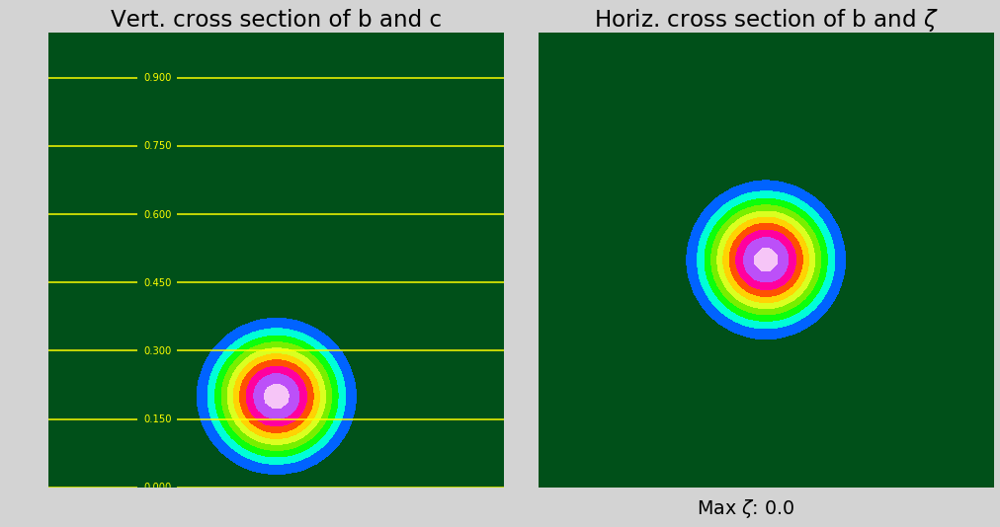

In [451]:
#quick,simple=plt.subplots(figsize=(12,6))
myfig = plt.figure(figsize=(16,8),facecolor='lightgrey')
ax1 = myfig.add_axes([0.08, 0.1, 0.4, .8*zmax/xmax],frameon=False) #vertical cross-section
ax2 = myfig.add_axes([0.51, 0.1, 0.4, .8*zmax/xmax],frameon=False) #horizontal cross-section
jp = Ny//2
kp = (Nz-1)//5
#jp=kp
ax1.axis('off')
ax2.axis('off')
ax1.contourf(xb[:,jp,:], zb[:,jp,:], bi[:,jp,:],np.linspace(-.05,1.05,12),zorder=1)
CS=ax1.contour(xb[:,jp,:], zb[:,jp,:], ci[:,jp,:],colors='yellow')
ax1.clabel(CS, inline=1, fontsize=10,colors='yellow')
ax1.set_title('Vert. cross section of b and c', fontsize=23);
ax2.contourf(xb[kp,:,:],yb[kp,:,:],bi[kp,:,:],np.linspace(-.05,1.05,12),zorder=1)
ax2.contour(xp[kp,:,:],yp[kp,:,:],vort0[kp,:-1,:-1],[0.01,0.05,0.1,0.5,1,3,5,7,9],colors='deeppink',zorder=3)
ax2.set_title('Horiz. cross section of b and $\zeta$',fontsize=23)
ax2.text(.35,-.05,'Max $\zeta$: ' + str(np.round(vort0[kp,:-1,:-1].max())),fontsize=19)




In [452]:
print("periodic=",periodic)    

dudt=0.*ui
dvdt=0.*vi
dwdt=0.*wi + bi


divaccel = div_Cgrid(dudt,dvdt,dwdt,dx,dy,dz)

print("prior, max divaccel",divaccel.max(),"min divaccel",divaccel.min())

inv_lapl_op = poisson3d_p_fft_prep(divaccel.shape,dx,dy,dz,periodic=periodic)
pi = poisson3d_p_fft(divaccel,inv_lapl_op,periodic=periodic)

pi = pi-pi.mean() # note PGF is independent of mean, but this prevents p.mean() from drifting

dudt[:,:,1:-1] += (pi[:,:,:-1]-pi[:,:,1:])/dx
dvdt[:,1:-1,:] += (pi[:,:-1,:]-pi[:,1:,:])/dy
dwdt[1:-1,:,:] += (pi[:-1,:,:]-pi[1:,:,:])/dz

if periodic:
    dudt[:,:,0] += ( pi[:,:,-1] - pi[:,:,0] )/dx
    dvdt[:,0,:] += ( pi[:,-1,:] - pi[:,0,:] )/dy
    dudt[:,:,-1] = dudt[:,:,0] 
    dvdt[:,-1,:] = dvdt[:,0,:]     
divaccel= div_Cgrid(dudt,dvdt,dwdt,dx,dy,dz)

print("after, max divaccel",divaccel.max(),"min divaccel",divaccel.min())


periodic= False
prior, max divaccel 7.784490014992336 min divaccel -7.7642922380587684
after, max divaccel 1.7053025658242404e-13 min divaccel -1.7408297026122455e-13


0.020640689656323433 -0.029866834523180372


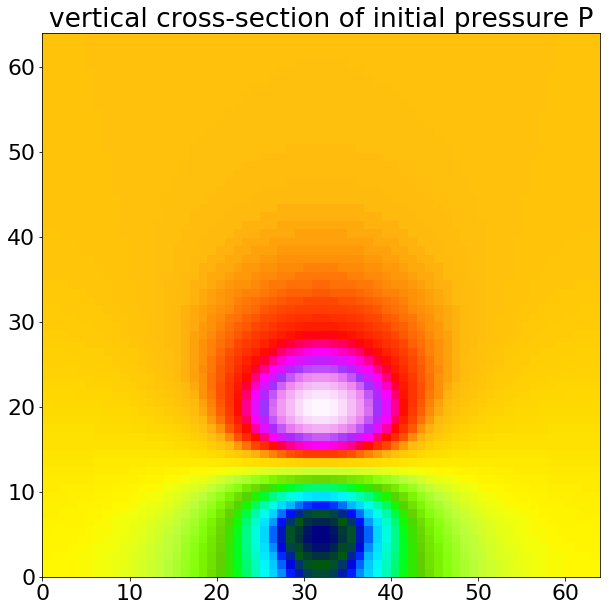

In [453]:
print(pi.max(),pi.min())
quick,simple=plt.subplots(figsize=(10,10))
simple.pcolor(pi[:,jp,:]) # pcolor is simple, and shows the pixels
simple.set_title("vertical cross-section of initial pressure P");

<hr/>
# Set up the animation plot

In [454]:
if outdir != None and not os.path.exists(outdir): os.mkdir(outdir)
myfig = plt.figure(figsize=(16,8),facecolor='lightgrey')
ax2 = myfig.add_axes([0.1, 0.1, 0.4, .8*zmax/xmax],frameon=False) # vertical cross-section
ax3 = myfig.add_axes([0.02, 0.3333, 0.05333, .5333]) # for colorbar
ax4 = myfig.add_axes([0.5, 0.1, 0.4, .8*zmax/xmax],frameon=False) # horizontal cross-section
ax3.axis('off')
ax2.axis('off')
ax4.axis('off')
#ax1 = myfig.add_axes([0.1, 0.0500, 0.5333, .2666]) # line plot axes
#plt.setp( ax2.get_xticklabels(), visible=False);
cbar_exists=False
plt.close()

In [455]:
def doplot(jp=None,kp=None,iwant='xz'):
    global cbar_exists
    ax2.clear()
     
# VERTICAL CROSS SECTION
    if iwant=='xz':        
        if jp is None: jp=Ny//2  
        ttl = ax2.set_title('Vert. cross section of b and c',fontsize=23,fontweight='heavy')
        CF = ax2.contourf(xb[:,jp,:],zb[:,jp,:],b[:,jp,:],np.linspace(-.05,1.05,12),zorder=1)
        ax2.contour(xp[:,jp,:],zp[:,jp,:],p[:,jp,:],.1*np.linspace(-2.05,2.05,42),colors=['w',],zorder=2)
        CS=ax2.contour(xb[:,jp,:],zb[:,jp,:],c[:,jp,:],[0.01,0.05,0.1,0.3,0.5,0.7,0.9,1.1],colors='yellow',zorder=3)
        ax2.clabel(CS, inline=1, fontsize=10,colors='yellow')
        ax2.annotate(expname, xy=(0.05,0.05),fontsize=19, fontweight='bold', color='yellow')
        vd=1
        speedmax=.5  # anticipate value of max  
        u_at_p = (u[:,jp,:-1]+u[:,jp,1:])*.5
        w_at_p = (w[:-1,jp,:]+w[1:,jp,:])*.5
        Q = ax2.quiver(xp[::vd,jp,::vd],zp[::vd,jp,::vd],u_at_p[::vd,::vd],w_at_p[::vd,::vd],
            scale=speedmax*Nx/vd,units='width',zorder=3)

    elif iwant=='yz':
        
        if jp is None: jp=Nx//2   
        ttl=ax2.set_title('Vert. cross section of b and c',fontsize=23, fontweight='heavy')
        CF = ax2.contourf(yb[:,:,jp],zb[:,:,jp],b[:,:,jp],np.linspace(-.05,1.05,12),zorder=1)
        ax2.contour(yp[:,:,jp],zp[:,:,jp],p[:,:,jp],.1*np.linspace(-2.05,2.05,42),colors=['w',],zorder=2)
        ax2.contourf(yb[:,:,jp],zb[:,:,jp],c[:,:,jp], np.linspace(-0.05,4.05,22))
        ax2.contour(yb[:,:,jp],zb[:,:,jp],c[:,:,jp],colors='yellow',zorder=3)
        vd=1
        speedmax=.5  # anticipate value of max  
        v_at_p = (v[:,:-1,jp]+v[:,1:,jp])*.5
        w_at_p = (w[:-1,:,jp]+w[1:,:,jp])*.5
        Q = ax2.quiver(yp[::vd,::vd,jp],zp[::vd,::vd,jp],v_at_p[::vd,::vd],w_at_p[::vd,::vd],
            scale=speedmax*Nx/vd,units='width',zorder=3)

        
    speedf= "%7.3f"  % speedmax
    ax2.quiverkey(Q,.4*xmax,-.04*zmax,speedmax, speedf,zorder=4)
    
    ax2.text(.0,-.04*zmax,'t={0:5.2f}'.format(t),fontsize=19)
    peristring=""
    if periodic: peristring="periodic"
    expt = "%d,%d,%d   f=%4.1f   b=%4.1f   %s" % (Nx,Ny,Nz,fcoriolis,buoy,peristring)
    ax2.text(.7*xmax,-.04*zmax, expt,fontsize=19)
    


# HORIZONTAL CROSS-SECTION 
    if kp is None: kp=Nz//2
        
    ax4.clear()     
    ax4.contourf(xb[kp,:,:],yb[kp,:,:],b[kp,:,:],np.linspace(-.05,1.05,12),zorder=1)
    ax4.contour(xp[kp,:,:],yp[kp,:,:],vorti[kp,:-1,:-1],[0.01,0.05,0.1,0.5,1,3,5,7,9,11,13,15,17,19,21],colors='deeppink',zorder=2)
    ax4.annotate('Max $\zeta$: ' + str(np.round(vorti[kp,:-1,:-1].max(),decimals=3)), xy=(0.35,0.05),
                 fontsize=19, fontweight='bold', color='deeppink')
    vd=1
    speedmax=.1 # anticipate value of max    
    u_at_p = (u[kp,:,:-1]+u[kp,:,1:])*.5
    v_at_p = (v[kp,:-1,:]+v[kp,1:,:])*.5
    Q2 = ax4.quiver(xp[kp,::vd,::vd],yp[kp,::vd,::vd],u_at_p[::vd,::vd],v_at_p[::vd,::vd],
        scale=speedmax*Nx/vd,units='width',zorder=3,color='white')
    
    speedf= "%7.3f"  % speedmax
    ax4.quiverkey(Q2,.4*xmax,-.04*ymax,speedmax, speedf,zorder=4)
    ax4.set_title('Horiz. cross section of b and $\zeta$',fontsize=23, fontweight='heavy')
    if not cbar_exists: #bad things happen if cbar is called more than once 
        cbar_exists = True
        mycbar = myfig.colorbar(CF,ax=ax3,fraction=0.3)
        mycbar.ax.yaxis.set_ticks_position('left')
        sooner = mycbar.ax.yaxis.get_ticklabels()
        for boomer in sooner:
            boomer.set_fontsize(12)
            
    ax2.axis('off')
    stop_clipping(ax2)
    ax4.axis('off')
    stop_clipping(ax4)

    clear_output(wait=True)

    display(myfig)   
    
    if outdir != None: 
        timestamp = round(t,2)
        pngname = outdir+'/%06d.png' % round(100*timestamp) 
        myfig.savefig(pngname, dpi=72, facecolor='w', edgecolor='w', orientation='portrait')  

<hr/>
<a name="Energy_stats_arrays"></a>

# Ready to run at t=0

In [456]:
b=bi.copy()
c=ci.copy()
u=ui.copy()
v=vi.copy()
w=wi.copy()
p=pi.copy()
vorti = vort0.copy() # not needed?


dbdta=[None]*3
dudta=[None]*3
dvdta=[None]*3
dwdta=[None]*3
dcdta=[None]*3
dvortdta = [None]*3

BW=[] # for time series of covariance [bw]
Bxyz=[] # for time series of volume integrated b in the domain
C=[]    # for time series of tracer
HS=[] # for time series of horizontal velocity in the domain
WS=[] # for the time series of wmax in the domain
VORT=[] # for time series of maximum vertical vorticity in the domain
CIRC = [] # for time series of circulation (show relatinship of stretching to vorticity)
PS=[] # for time series of surface pressure in the domain
PC=[] # for central pressure, with Coriolis
PC1=[] # for central pressure, without Coriolis
te=[] # for time series of total energy in the domain
ke=[] # for time series of total kinetic energy in the domain
pe=[] # for time series or total potential energy in the domain
times = [] # time of the diagnostic
t = 0 #initial time
tstart = 0 # for time series plot
nstep = 0
tplot = 0 # next time to plot
dplot = .1 # interval between plots
dt = 0.5*dz/1.
#doplot(kp=kp,iwant='xz')


<hr/>
<a name="Stepforward"></a>

# Step forward in time

You can repeatedly increase `tstop` and rerun the following cell.

In [457]:
tstop = 2.5

while t < tstop + dt/2.:
    
    bnd = 'slip'
    uw = u_to_w(u,bnd)
    vw = v_to_w(v,bnd)
    if periodic: bnd='per'
    vu = v_to_u(v,bnd)
    wu = w_to_u(w,bnd)
    uv = u_to_v(u,bnd)
    wv = w_to_v(w,bnd)
    
    if periodic:
        dudt =  advect_3dp(u,u,vu,wu,dx,dy,dz,'u')
        dvdt =  advect_3dp(v,uv,v,wv,dx,dy,dz,'v')
        dbdt =  advect_3dp(b,uw,vw,w,dx,dy,dz,'w')
        dcdt =  advect_3dp(c,uw,vw,w,dx,dy,dz,'w')
        dwdt =  advect_3dp(w,uw,vw,w,dx,dy,dz,'w')
    else:
        dudt =  advect_3d(u,u,vu,wu,dx,dy,dz)
        dvdt =  advect_3d(v,uv,v,wv,dx,dy,dz)
        dbdt =  advect_3d(b,uw,vw,w,dx,dy,dz)
        dcdt =  advect_3d(c,uw,vw,w,dx,dy,dz)
        dwdt =  advect_3d(w,uw,vw,w,dx,dy,dz)   
    if fcoriolis!=0.: dudt +=  fcoriolis*vu #Coriolis term 
    if fcoriolis!=0.: dvdt += -fcoriolis*uv #Coriolis term
    dwdt += b
    


# Ensure no normal component of velocity develops on the boundaries:
    if not periodic:
        dudt[:,:,0]=0.
        dudt[:,:,-1]=0.
        dvdt[:,0,:]=0.
        dvdt[:,-1,:]=0.
    dwdt[0,:,:]=0.
    dwdt[-1,:,:]=0.
    

    divaccel= div_Cgrid(dudt,dvdt,dwdt,dx,dy,dz)
    divvel = div_Cgrid(u,v,w,dx,dy,dz)

    p = poisson3d_p_fft(divaccel + .4*divvel/dt, inv_lapl_op, periodic=periodic)

    p = p - p.mean() 
    
    dudt[:,:,1:-1] += ( p[:,:,:-1] - p[:,:,1:] )/dx
    dvdt[:,1:-1,:] += ( p[:,:-1,:] - p[:,1:,:] )/dy
    dwdt[1:-1,:,:] += ( p[:-1,:,:] - p[1:,:,:] )/dz

    if periodic:
        dudt[:,:,0] += ( p[:,:,-1] - p[:,:,0] )/dx
        dvdt[:,0,:] += ( p[:,-1,:] - p[:,0,:] )/dy

        
    if periodic:
        dudt[:,:,-1] = dudt[:,:,0] 
        dvdt[:,-1,:] = dvdt[:,0,:]         

    dudta=[dudt.copy()]+dudta[:-1]
    dvdta=[dvdt.copy()]+dvdta[:-1]
    dwdta=[dwdt.copy()]+dwdta[:-1]
    dbdta=[dbdt.copy()]+dbdta[:-1]
    dcdta=[dcdt.copy()]+dcdta[:-1]

    
#   step forward in time:
    nstep += 1
    abnow = min(nstep,aborder)
    b += dt*ab_blend(dbdta,abnow) 
    c += dt*ab_blend(dcdta,abnow)
    u += dt*ab_blend(dudta,abnow) 
    v += dt*ab_blend(dvdta,abnow) 
    w += dt*ab_blend(dwdta,abnow)
    t += dt
    

    U=u_to_p(u)
    V=v_to_p(v)
    W=w_to_p(w)
    B=w_to_p(b)
    
    # Montitor stats
    # Energetics
    speed = np.sqrt(U*U + V*V + W*W)  # Calculate magnitude of velocity
    kinEn = (.5*speed**2).mean()      # kinetic energy
    #potEn = (.5*B**2).mean()
    potEn = -(B*zp).mean()
    
    # Vorticity
    vorti = vortp(u,v,dx,dy)          # original vorticty
    circi = dx*dy*vorti.sum()         # circulation
    
    # Pressure
    ps = p[0,Nx//2,Ny//2]             # Surface pressure
    
    # Integrate central pressure wrt r
    # Find vortex center
    cdist = np.zeros(len(xp[0,Ny//2,Nx//2:]))
    cordist = cdist.copy()
    
    for i in range(Nx//2): # calculate the radius from the center in order to determine 
                           # acceleration due to centrifugal and Coriolis effect
        if i is not 0: 
            cdist[i] = V[0,Ny//2,i]**2/(xp[0,Ny//2,i]-xp[0,Ny//2,Nx//2]) # centrifugal 
            cordist[i] = fcoriolis*V[0,Ny//2,i] # coriolis 
    
    pc1 = np.trapz(cdist,dx=dx) # calculate centrifulgal term for central pressure from prob 3
    pc2 = np.trapz(cordist,dx=dx) # calculate coriolis term for central pressure from prob 3
    pc = (pc1 + pc2) # Complete integral
    
    # Volume integral of b
    bxyz = dx*dy*dz*b.sum()                
    # Covariance of BW
    bw = (b*w).mean()
    # Final tracer amount
    cf = c.sum()
    
   
    
    #Write stats to time arrays
    ke.append(kinEn)
    pe.append(potEn)
    te.append(kinEn+potEn)
    times.append(t)
    VORT.append(vorti.max())
    CIRC.append(circi)
    HS.append(v[0,:,:].max())
    WS.append(w.max())
    PS.append(ps.min())
    Bxyz.append(bxyz)
    BW.append(bw.mean())
    C.append(c.sum())  
    PC.append(pc)
    PC1.append(pc1)
    
    
    #if  tplot-dt/2. < t: 
    #    doplot(kp=kp,iwant='xz')
    #    tplot = tplot + dplot
#plt.close()


In [458]:
divvel=div_Cgrid(u,v,w,dx,dy,dz)
print("should be small:",divvel.max(),divvel.min())

should be small: 2.609024107869118e-14 -3.019806626980426e-14


<a name="Animation_and_stats"></a>
## Build the animation and plot the statistics

In [459]:
# From Wei-Ming's example
import imageio
 
path = "/Users/kryderfox/Documents/GitHub/MPO_663/Fox_Assignment_5/f_5/"#+expname
os.chdir(path)
filenames = sorted(glob.glob('*.png'))
images = []
for filename in filenames:
    images.append(imageio.imread(filename))
    
imageio.mimsave('./Pet_tornado3d_f_5.gif', images) # convert plots into a gif movie



### Control Run

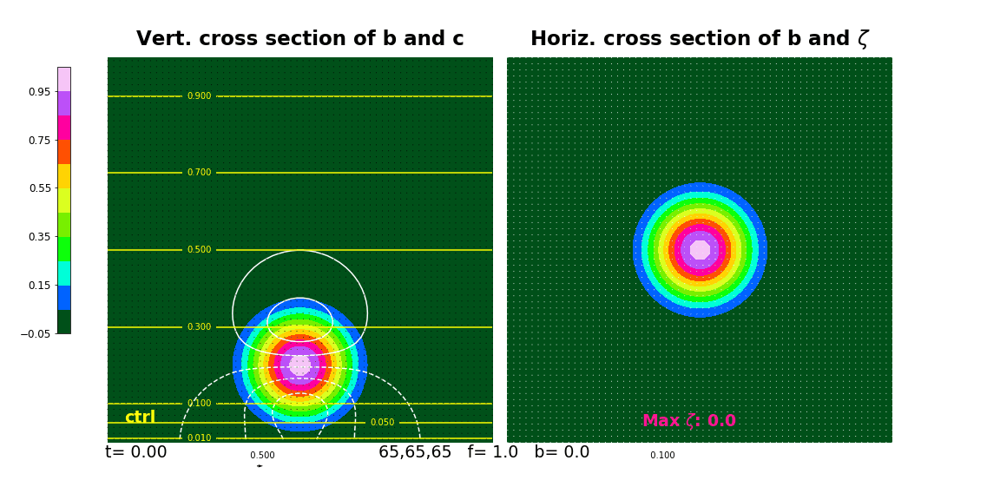

In [460]:
path = "/Users/kryderfox/Documents/GitHub/MPO_663/Fox_Assignment_5/ctrl/" 
os.chdir(path)
with open('Pet_tornado3d_ctrl.gif','rb') as file:
    display(Image(file.read()))

### Coriolis = 5

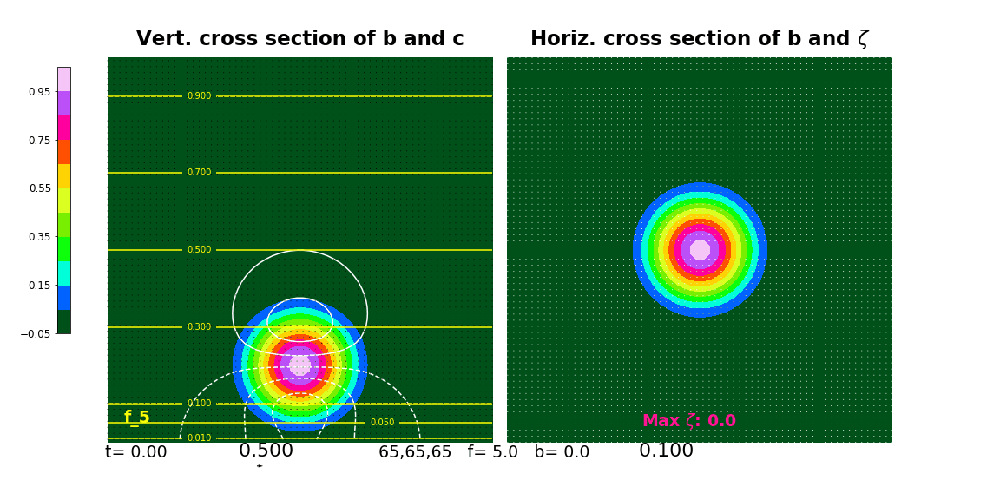

In [461]:
path = "/Users/kryderfox/Documents/GitHub/MPO_663/Fox_Assignment_5/f_5/" 
os.chdir(path)
with open('Pet_tornado3d_f_5.gif','rb') as file:
    display(Image(file.read()))


### Coriolis = 8

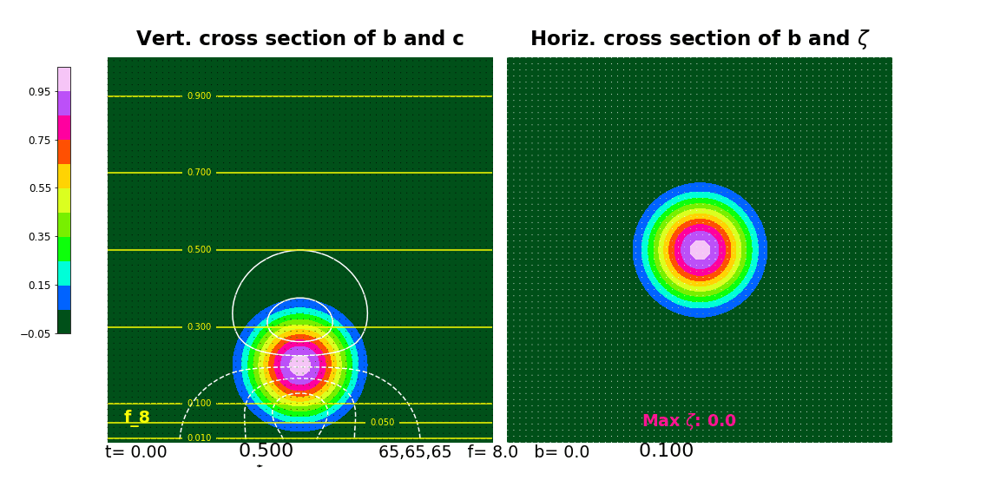

In [462]:
path = "/Users/kryderfox/Documents/GitHub/MPO_663/Fox_Assignment_5/f_8/" 
os.chdir(path)
with open('Pet_tornado3d_f_8.gif','rb') as file:
    display(Image(file.read()))

### Coriolis = 11

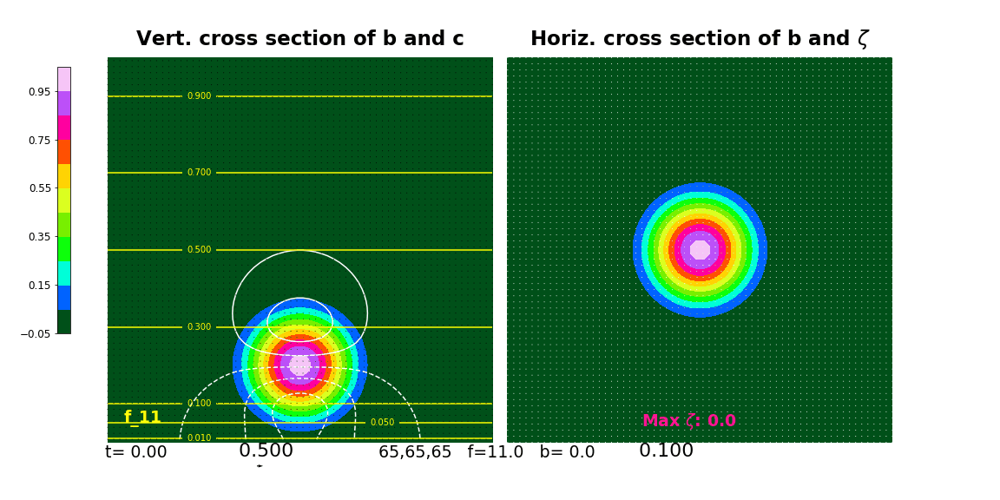

In [463]:
path = "/Users/kryderfox/Documents/GitHub/MPO_663/Fox_Assignment_5/f_11/" 
os.chdir(path)
with open('Pet_tornado3d_f_11.gif','rb') as file:
    display(Image(file.read()))

### Coriolis = 14

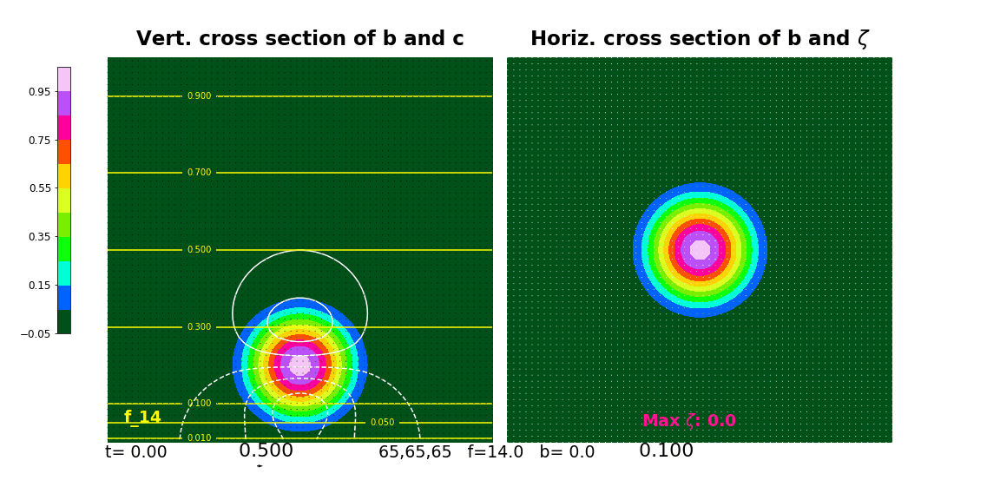

In [464]:
path = "/Users/kryderfox/Documents/GitHub/MPO_663/Fox_Assignment_5/f_14/" 
os.chdir(path)
with open('Pet_tornado3d_f_14.gif','rb') as file:
    display(Image(file.read()))

### Coriolis = 17

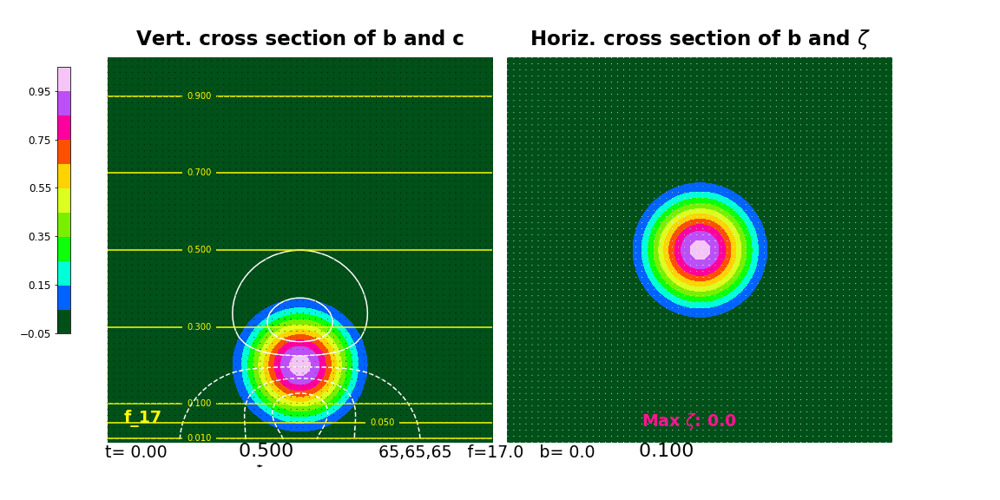

In [465]:
path = "/Users/kryderfox/Documents/GitHub/MPO_663/Fox_Assignment_5/f_17/" 
os.chdir(path)
with open('Pet_tornado3d_f_17.gif','rb') as file:
    display(Image(file.read()))

In [469]:
# Let's save our variables!

vars=np.zeros((10,len(ke)))
vars[0,:]=np.array(ke)
vars[1,:]=np.array(HS)
vars[2,:]=np.array(WS)
vars[3,:]=np.array(VORT)
vars[4,:]=np.array(CIRC)
vars[5,:]=np.array(PS)
vars[6,:]=np.array(PC)
vars[7,:]=np.array(Bxyz)
vars[8,:]=np.array(BW)
vars[9,:]=np.array(C)

np.savetxt(expname + '_vars', vars)

## Examine Statistics

### Summarize findings

<h2 style='padding: 10px'>3D Tornado; Variable Coriolis</h2><table class='table table-striped'> <thead> <tr> <th>Param</th> <th>v$_{max}$</th> <th>$\zeta_{max}$</th> <th>P$_{s_{max}}$</th> <th> P'$_{s_{max}}$</th> <th>Qualitative </th> </tr> </thead> <tbody> <tr> <th scope='row'>Ctrl</th> <td>0.1130</td> <td>44.99</td> <td>-0.0359</td> <td> -0.0402</td> <td>hour glass; strong outflow</td> </tr> <tr> <th scope='row'>f = 5</th> <td>0.2752</td> <td>47.42</td> <td>-0.2454</td> <td>-0.2334</td> <td>extended hour glass; some outflow</td> </tr> <tr> <th scope='row'>f = 8</th> <td>0.2459</td> <td>37.96</td> <td>-0.2782</td> <td>-0.2715</td> <td>extended pear; almost no outflow</td> </tr> <tr> <th scope='row'>f = 11</th> <td>0.1707</td> <td>17.82</td> <td>-0.2444</td> <td>-0.2452</td> <td>shorter pear; no outflow</td> </tr> <tr> <th scope='row'>f = 14</th> <td>0.1261</td> <td>8.23</td> <td>-0.2213</td> <td>-0.2362</td> <td>pear; no outflow</td> </tr> <tr> <th scope='row' >f = 17</th> <td>0.1011</td> <td>4.40</td> <td>-0.2086</td> <td>-0.2188</td> <td>egg; no outflow</td> </tr> </tbody> </table>


In [467]:
### Plot all experiments

0.005023106697852182


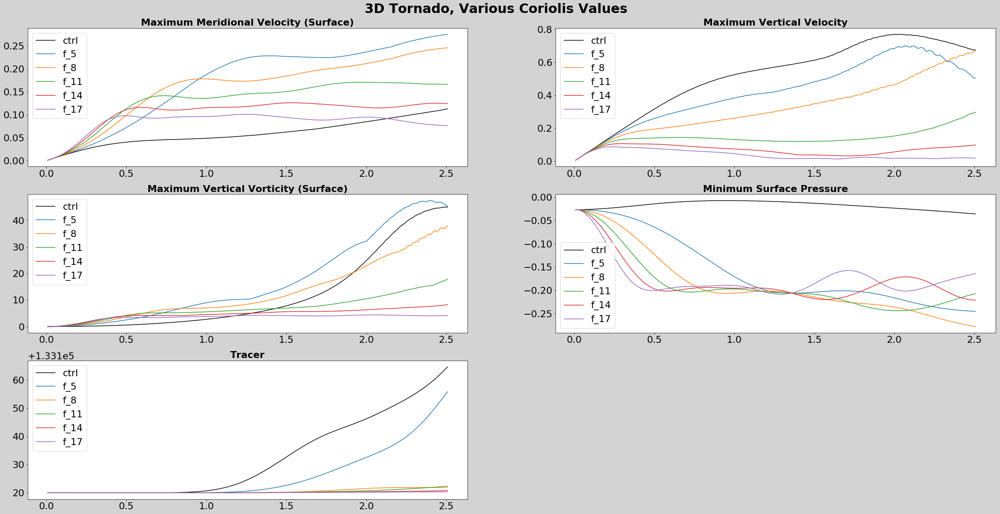

In [487]:
experiments = ['ctrl','f_5','f_8','f_11','f_14','f_17']
vmax_t = np.zeros((len(experiments),len(HS))); 
wmax_t = vmax_t.copy(); VORT_t = vmax_t.copy();
PS_t = vmax_t.copy(); C_t = vmax_t.copy()
PC_t = vmax_t.copy()

for idx, fid in enumerate(experiments):
    os.chdir('/Users/kryderfox/Documents/GitHub/MPO_663/Fox_Assignment_5/'+fid)
    data = np.loadtxt(fid+'_vars')
    vmax_t[idx,:] = data[1,:] 
    wmax_t[idx,:] = data[2,:]
    VORT_t[idx,:] = data[3,:]
    PS_t[idx,:] = data[5,:]
    PC_t[idx,:] = data[6,:]
    C_t[idx,:] = data[9,:]

# plotting 
fig = plt.figure(figsize=(40,20),facecolor='lightgrey')
fig.suptitle("3D Tornado, Various Coriolis Values", fontsize=30,fontweight='bold',y=0.92)
ax = plt.subplot(3,2,1)
ax.plot(times,vmax_t[0,:],'k',times,vmax_t[1,:],times,vmax_t[2,:],times,vmax_t[3,:],times,vmax_t[4,:],times,vmax_t[5,:])
ax.legend(experiments)
ax.set_title("Maximum Meridional Velocity (Surface)",fontsize=22,fontweight='heavy')

ax = plt.subplot(3,2,2)
ax.plot(times,wmax_t[0,:],'k',times,wmax_t[1,:],times,wmax_t[2,:],times,wmax_t[3,:],times,wmax_t[4,:],times,wmax_t[5,:])
ax.legend(experiments)
ax.set_title("Maximum Vertical Velocity",fontsize=22,fontweight='heavy')

ax = plt.subplot(3,2,3)
ax.plot(times,VORT_t[0,:],'k',times,VORT_t[1,:],times,VORT_t[2,:],times,VORT_t[3,:],times,VORT_t[4,:],times,VORT_t[5,:])
ax.legend(experiments)
ax.set_title("Maximum Vertical Vorticity (Surface)",fontsize=22,fontweight='heavy')

ax = plt.subplot(3,2,4)
ax.plot(times,PS_t[0,:],'k',times,PS_t[1,:],times,PS_t[2,:],times,PS_t[3,:],times,PS_t[4,:],times,PS_t[5,:])
ax.legend(experiments)
ax.set_title("Minimum Surface Pressure",fontsize=22,fontweight='heavy')

ax = plt.subplot(3,2,5)
ax.plot(times,C_t[0,:],'k',times,C_t[1,:],times,C_t[2,:],times,C_t[3,:],times,C_t[4,:],times,C_t[5,:])
ax.legend(experiments)
ax.set_title("Tracer",fontsize=22,fontweight='heavy')

#plt.savefig('./Tornado3d_tot_stats_.png')
#plt.show()

print(np.min(wmax_t[0,:]))



# Compare Stats
fig = plt.figure(figsize=(35,25),facecolor='lightgrey')
fig.suptitle("3D Tornado "+expname, fontsize=30,fontweight='bold',y=0.92)

ax=plt.subplot(3,3,1)
ax.plot(times,ke,'-.b',linewidth=3)
ax.plot(times,pe,'-.r',linewidth=3)
ax.plot(times,te,'k',linewidth=3)
ax.set_title('Domain Averaged Energetics',fontsize=22,fontweight='heavy')
ax.set_xlabel('time')
ax.legend(['KE','PE','E$_{tot}$'])
ax.yaxis.set_major_formatter(FormatStrFormatter('%.2f'))

ax=plt.subplot(3,3,2)
ax.plot(times,HS,linewidth=3)
ax.set_title('Maximum Meridional Velocity (Surface)',fontsize=22,fontweight='heavy')
ax.set_xlabel('time')

ax=plt.subplot(3,3,3)
ax.plot(times,WS,linewidth=3)
ax.set_title('Maximum Vertical Velocity',fontsize=22,fontweight='heavy')
ax.set_xlabel('time')

ax=plt.subplot(3,3,4)
ax.plot(times,Bxyz,linewidth=3)
ax.set_title('Vertically Averaged Buoyancy',fontsize=22,fontweight='heavy')
ax.set_xlabel('time')
ax.yaxis.set_major_formatter(FormatStrFormatter('%.4f'))

ax=plt.subplot(3,3,5)
ax.plot(times,BW,linewidth=3)
ax.set_title('Covariance of Buoy. and Vert. Velocity',fontsize=22,fontweight='heavy')
ax.set_xlabel('time')
ax.yaxis.set_major_formatter(FormatStrFormatter('%.4f'))

ax=plt.subplot(3,3,6)
ax.plot(times,PS,'k',linewidth=3)
ax.plot(times,PC,'-.b',linewidth=3)
ax.plot(times,PC1,'-.r',linewidth=3)
ax.set_title('Actual v. Predicted Surf. Pressure',fontsize=22,fontweight='heavy')
ax.set_xlabel('time')
ax.legend(['P','P"$_{tot}$','P$_{centrif}$'])
ax.yaxis.set_major_formatter(FormatStrFormatter('%.2f'))

ax=plt.subplot(3,3,7)
ax.plot(times,VORT,linewidth=3)
ax.set_title('Maximum Vertical Vorticity (Surface))',fontsize=22,fontweight='heavy')
ax.set_xlabel('time')
ax.yaxis.set_major_formatter(FormatStrFormatter('%.2f'))

ax=plt.subplot(3,3,8)
ax.plot(times,C,linewidth=3)
ax.set_title('Total Tracer',fontsize=22,fontweight='heavy')
ax.set_xlabel('time')

plt.savefig('./Tornado3d_stats_'+ expname+'.png')
plt.show()

<a name="Student_tasks"></a>

# Student Tasks

## 1. Make more stats monitoring outputs

Write a function to calculate vertical vorticity $\zeta$. 

Improve the monitoring section to show time series of volume-integrated $b$, maximum $v$, maximum $\zeta$, minimum $p$ at the surface, skew of w, 3D covariance [bw], or other useful statistics in addition to the energies already there. Test these monitoring tools with the control_run case. 


## 2. Tracer displacement and vortex stretching 

Add a field $c(x,y,z,t)$ that has no effect on the dynamics.  You need to simply follow what is done for $b$, except $c$ does not appear in any momentum equation. Initialize $c(x,y,z,0)=z$ or $c(x,y,z,0)=r$, a tracer of initial parcel position. Add contours of $c$ in `doplot`, in the vertical cross-section.

From the deformation of $c$, you should be able to discern the amount of vortex stretching that occurs in the "tornado". 

Plot contours of relative vorticity $\zeta$ in the horizontal cross section of `doplot`.

Perform some calculations that check to see if the increase of $\zeta$ in the horizontal cross section is consistent with the stretching you deduced from the contours of $c$ in the vertical cross section.

## 3. Relate single point stats (Vmax, central pressure) to flow integrals and initial conditions

Can you to validate this relationship between an integral and a point value, the pressure depression in the center of the vortex?

$$
p'_{central} = -\int_{r=large}^{r=0} {(v_{tan}^2/r + fv_{tan}) dr}
$$

How important is the Coriolis force in your cases? That is, how much of the answer could you get from 

$$
p'_{central} = -\int_{r=large}^{r=0} {(v_{tan}^2/r) dr}
$$

## 4. Parameter sweep!

To build confidence, go to the <a href="#Initialize">double red bar</a> and adjust `fcoriolis`, as one simple experiment. Here are reference results for `fcoriolis` = 0,1,2,3:

<img src="http://metr4323.net/img/fcor0.png">
<img src="http://metr4323.net/img/fcor1.png">
<img src="http://metr4323.net/img/fcor2.png">
<img src="http://metr4323.net/img/fcor3.png">


## Your own parameter  

The strength of the surface rotation (by various different measures) has various dependencies on f, and on the warm bubble. 

Horizontal displacement is what makes tangential wind, so width may matter. But we know bubbles penetrate better when they are tall and narrow, because BPGF opposes b less effectively, so maybe a tall bubble has a greater "thermodynamic speed limit" (ask Dr. Nolan!) And of course f matters, but for really large f the bubble can't even rise very far before geostrophic balance develops and holds it in place. 

**With 3 students, let's explore 3 parameters, over 5 values:**

1. Wei-Ming: Width of the bubble (keeping volume-integrated b constant by adjusting bmax). 
1. Haozhe: Height of the bubble (keeping volume-integrated b constant by adjusting bmax).
1. Ryder: Coriolis force: try really large values where geostrophic balance soon keeps it from rising.

**Make 5 experiments, based around the control run (like two doublings/halvings).**

**Be prepared to explain your results in a class discussion on Thursday with Dr. Nolan.**